# Compute the correlation between subsequent IMC:MALDI-IHC slice

## Set up dependency

In [2]:
import os, sys
import numpy as np
import pandas as pd
import tifffile as tif
import seaborn as sns
import matplotlib.pyplot as plt
import skimage as ski
import tqdm
from scipy.stats import pearsonr

In [3]:
data_dir = '/mnt/central_nas/datasharing/Quentin/IMC_MALDI_gutenTAG'
input_dir = os.path.join(data_dir, 'Registered/registered_2609')

panel_name = 'channel_mapping.xlsx'
imc_name = '20250304_QH_MALDI_IMC_GutenTAG_JA_2609_004.tiff'

# to be changed
maldi_type = 'ITO_MALDI'
maldi_name = 'ITO_MALDI_right_to_IMC_2609_serial.tiff'

## Set up functions

In [4]:
def panel_preprocess(panel_path, maldi_type):
    panel_df = pd.read_excel(panel_path, sheet_name="No_dup")
    # replace all NaN values with 0
    panel_df.fillna(0, inplace=True)
    # make the IMC, ITO_MALDI, and GLASS_MALDI dtype int, ignoring NaN values
    panel_df['IMC'] = pd.to_numeric(panel_df['IMC'], errors='coerce')
    panel_df[maldi_type] = pd.to_numeric(panel_df[maldi_type], errors='coerce')

    # find channels if their corresponding IMC value is not NaN
    imc_channels = panel_df['Marker'][panel_df['IMC'] != 0].tolist()
    maldi_channels = panel_df['Marker'][panel_df[maldi_type] != 0].tolist()

    # remove 0 from imc_channels and maldi_channels
    imc_channels = [ch for ch in imc_channels if ch != 0]
    maldi_channels = [ch for ch in maldi_channels if ch != 0]
    
    return panel_df, imc_channels, maldi_channels

def get_common_channels(img1_channels, img2_channels):
    """Find common channels between two images."""
    common_channels = list(set(img1_channels) & set(img2_channels))
    return list(set(img1_channels) & set(img2_channels))

def extract_common_channels(image, panel_df, image_type, common_channels):
    """Extract the indices and slices of the common channels."""
    indices = [panel_df[image_type][panel_df['Marker'] == ch].values[0].astype(np.uint8) for ch in common_channels]
    # minus one to convert to zero-based indexing
    indices = np.array(indices) - 1
    return image[indices], indices

def compute_spatial_correlation(image1, image2, common_channels):
    """Compute Pearson correlation between corresponding channels."""
    correlations = {}
    for i, ch in enumerate(common_channels):
        flat1 = image1[i].flatten()
        flat2 = image2[i].flatten()
        corr, _ = pearsonr(flat1, flat2)
        correlations[ch] = corr
    return correlations

def plot_correlation_heatmap(correlations):
    """Plot a heatmap of the correlation values."""
    df = pd.DataFrame(list(correlations.items()), columns=["Channel", "Correlation"])
    df = df.set_index("Channel")
    plt.figure(figsize=(8, 6))
    sns.heatmap(df, annot=True, cmap="coolwarm", vmin=-1, vmax=1, linewidths=0.5)
    plt.title("Spatial Correlation Heatmap")
    plt.show()

def compute_spatial_colocalization(image1, image2, common_channels):
    """Compute binary colocalization using Intersection over Union (IoU)."""
    ious = {}
    for i, ch in enumerate(common_channels):
        # Thresholding to create binary images by otsu thresholding
        threshold1 = ski.filters.threshold_otsu(image1[i])
        threshold2 = ski.filters.threshold_otsu(image2[i])
        binary1 = image1[i] > threshold1
        binary2 = image2[i] > threshold2

        # Compute intersection and union
        intersection = np.sum(binary1 & binary2)
        union = np.sum(binary1 | binary2)

        # Compute IoU
        iou = intersection / union if union != 0 else 0
        ious[ch] = iou
    return ious

def plot_colocalization(ious):
    """Plot a bar chart of the IoU values."""
    df = pd.DataFrame(list(ious.items()), columns=["Channel", "IoU"])
    plt.figure(figsize=(10, 6))
    sns.barplot(x="Channel", y="IoU", data=df)
    plt.title("Spatial Colocalization (IoU) Values")
    plt.xticks(rotation=45)
    plt.show()
    
def main(image1_path, image2_path, panel_path):
    img1 = tif.imread(image1_path)
    # flip imc image upside down
    img1 = np.flip(img1, axis=1)
    img2 = tif.imread(image2_path)
    panel_df, channels1, channels2 = panel_preprocess(panel_path, maldi_type)

    common_channels = get_common_channels(channels1, channels2)
    print(f"Number of common channels: {len(common_channels)}")
    print(f"Common channels: {common_channels}")
    img1_common, _ = extract_common_channels(img1, panel_df, 'IMC', common_channels)
    img2_common, _ = extract_common_channels(img2, panel_df, maldi_type, common_channels)
    
    
    # PIXEL-level correlation
    correlations = compute_spatial_correlation(img1_common, img2_common, common_channels)
    plot_correlation_heatmap(correlations)
    
    # for ch, corr in correlations.items():
    #     print(f"Channel: {ch}, Pearson Correlation: {corr:.4f}")
    
    # Binary colocalization analysis
    ious = compute_spatial_colocalization(img1_common, img2_common, common_channels)
    plot_colocalization(ious)
    
    
    return img1_common, img2_common, panel_df, common_channels, correlations, ious


## Load data and run the analysis

Number of common channels: 22
Common channels: ['Glucose Transporter GLUT1', 'PTEN', 'CD56', 'b-Catenin', 'Cytokeratin 8/18', 'Caveolin-1', 'CD3 epsilon', 'SMA', 'p53', 'Smad2/3', 'SOX10', 'CD38', 'Iridium', 'Complement C3', 'pan Cytokeratin', 'Vimentin', 'Collagen I', 'NFkB (p65)', 'CD44', 'FSP1 / S100A4', 'CD20', 'HLA-DR']


/tmp/ipykernel_219121/1483484543.py:37: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, _ = pearsonr(flat1, flat2)


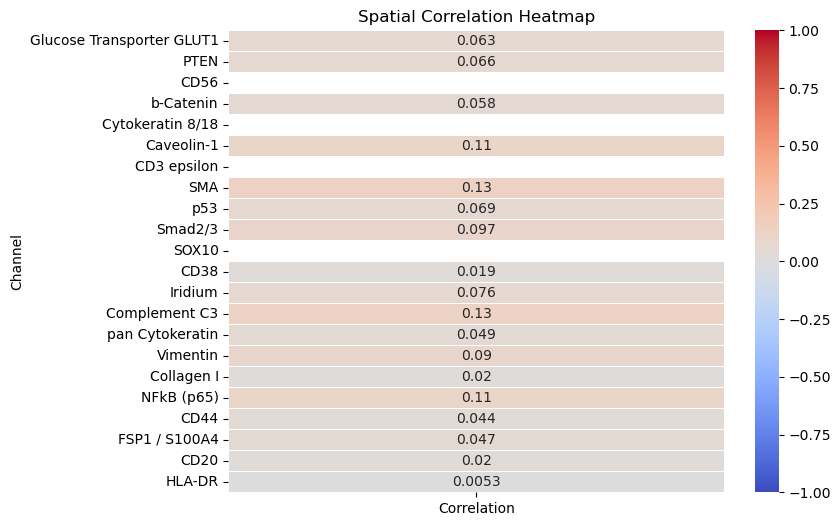

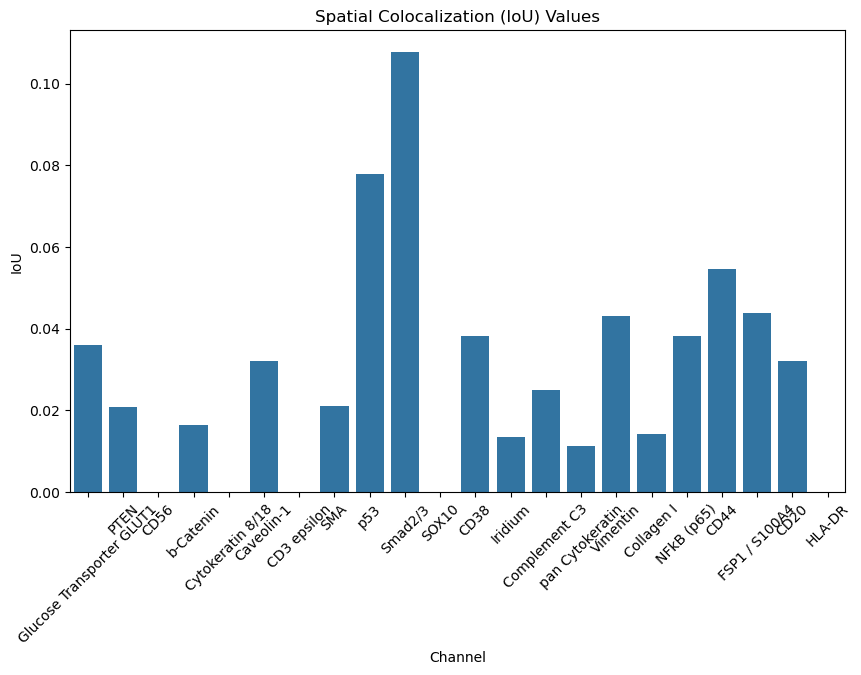

In [5]:
imc_path = os.path.join(input_dir, imc_name)
maldi_path = os.path.join(input_dir, maldi_name)
panel_path = os.path.join(input_dir, panel_name)

img1, img2, panel_df, common_channels, correlations, ious = main(imc_path, maldi_path, panel_path)

Plot the top few channels with high correlations

In [7]:
# add the correlation and iou values to the panel_df
panel_df['Correlation'] = panel_df['Marker'].map(correlations)
panel_df['IoU'] = panel_df['Marker'].map(ious)
# sort according to correlation
panel_df = panel_df.sort_values(by='Correlation', ascending=False)

panel_df

,E1,E2,Marker,IMC,ITO_MALDI,GLASS_MALDI,Correlation,IoU
10,Nd(148),148Nd,SMA,10.0,20.0,18.0,0.134576,0.021036
6,Nd(143),143Nd,Complement C3,6.0,15.0,13.0,0.125426,0.024896
16,Dy(162),162Dy,NFkB (p65),16.0,8.0,6.0,0.107634,0.038263
26,Pt(195),195Pt,Caveolin-1,26.0,22.0,20.0,0.107329,0.032109
17,Dy(164),164Dy,Smad2/3,17.0,3.0,3.0,0.097008,0.107698
19,Tm(169),169Tm,Vimentin,19.0,18.0,16.0,0.090040,0.043166
23,Ir(191),191Ir,Iridium,23.0,25.0,23.0,0.076093,0.013600
24,Ir(193),193Ir,Iridium,24.0,25.0,23.0,0.076093,0.013600
14,Sm(154),154Sm,p53,14.0,10.0,8.0,0.068687,0.077934
5,Nd(142),142Nd,PTEN,5.0,16.0,14.0,0.065882,0.020907


In [8]:
# plot the imc and maldi images side by side for the top 7 channels
# plot imc on the left and maldi on the right
def plot_side_by_side(img1, img2, panel_df, num_channels, common_channels):
    # pick top num_channel channels
    top_channels = panel_df.head(num_channels)['Marker'].tolist()
    fig, axes = plt.subplots(num_channels, 2, figsize=(10, num_channels * 3.5), dpi=300)
    for i, ch in enumerate(top_channels):
        # find the index of the channel in common_channels
        index = common_channels.index(ch)
        ax1 = axes[i, 0]
        ax2 = axes[i, 1]
        ax1.imshow(img1[index], cmap='gray', vmin=0, vmax=2)
        
        ax2.imshow(img2[index], cmap='gray')
        ax1.set_title(f"IMC {ch}")
        ax2.set_title(f"{maldi_type} {ch}")
        ax1.axis('off')
        ax2.axis('off')
    plt.tight_layout()
    # save the figure
    output_path = os.path.join(input_dir, 'imc_vs_maldi.tiff')
    plt.savefig(output_path, dpi=300)
    plt.show()

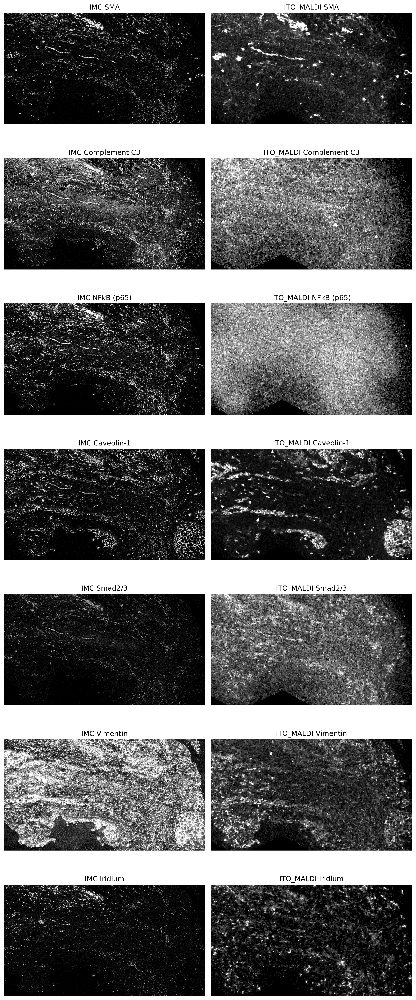

In [9]:
plot_side_by_side(img1, img2, panel_df, 7, common_channels)